In [1]:
import tensorflow as tf
import matplotlib as mpl
import matplotlib.pyplot as plt
import pathlib

mpl.rcParams['figure.figsize'] = (8, 8)
mpl.rcParams['axes.grid'] = False


#------------- Load in some helpful packages I may use -------------------------

import matplotlib.pyplot as plt
from skimage.transform import resize   #ERROR HERE COMMENT OUT
%matplotlib inline

from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
import numpy as np # linear algebra
from PIL import Image
import random

In [2]:
image_path_base = './LinnaeusSubset/{}/{}.jpg'

In [3]:
pretrained_model = tf.keras.applications.MobileNetV2(include_top=True,
                                                     weights='imagenet')
pretrained_model.trainable = False

# ImageNet labels
decode_predictions = tf.keras.applications.mobilenet_v2.decode_predictions

In [4]:
# Helper function to preprocess the image so that it can be inputted in MobileNetV2
def preprocess(image):
  image = tf.cast(image, tf.float32)
  image = tf.image.resize(image, (224, 224))
  image = tf.keras.applications.mobilenet_v2.preprocess_input(image)
  image = image[None, ...]
  return image

# Helper function to extract labels from probability vector
def get_imagenet_label(probs):
  return decode_predictions(probs, top=1)[0][0]

In [5]:
def display_images(image, description):
  _, label, confidence = get_imagenet_label(pretrained_model.predict(image))
  plt.figure()
  plt.imshow(image[0]*0.5+0.5)
  plt.title('{} \n {} : {:.2f}% Confidence'.format(description,
                                                   label, confidence*100))
  plt.show()

In [6]:
loss_object = tf.keras.losses.CategoricalCrossentropy()

def create_adversarial_pattern(input_image, input_label):
  with tf.GradientTape() as tape:
    tape.watch(input_image)
    prediction = pretrained_model(input_image)
    loss = loss_object(input_label, prediction)

  # Get the gradients of the loss w.r.t to the input image.
  gradient = tape.gradient(loss, input_image)
  # Get the sign of the gradients to create the perturbation
  signed_grad = tf.sign(gradient)
  return signed_grad

In [7]:
def show_images_perturbed(index_num,image):
    image = preprocess(image)
    image_probs = pretrained_model.predict(image)
    plt.figure()
    plt.imshow(image[0] * 0.5 + 0.5)  # To change [-1, 1] to [0,1]
    _, image_class, class_confidence = get_imagenet_label(image_probs)
    plt.title('{} : {:.2f}% Confidence'.format(image_class, class_confidence*100))
    plt.show()
    # Get the input label of the image.
    index = index_num
    label = tf.one_hot(index, image_probs.shape[-1])
    label = tf.reshape(label, (1, image_probs.shape[-1]))

    perturbations = create_adversarial_pattern(image, label)
    plt.imshow(perturbations[0] * 0.5 + 0.5);  # To change [-1, 1] to [0,1]

    epsilons = [0, 0.01, 0.1, 0.15]
    descriptions = [('Epsilon = {:0.3f}'.format(eps) if eps else 'Input')
                    for eps in epsilons]

    for i, eps in enumerate(epsilons):
      adv_x = image + eps*perturbations
      adv_x = tf.clip_by_value(adv_x, -1, 1)
      display_images(adv_x, descriptions[i])

## Testing the MobileNetV2 with images that are 256x256

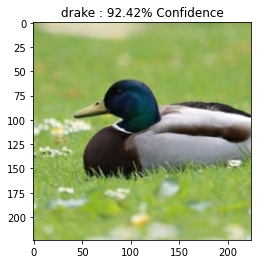

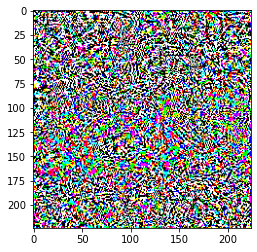

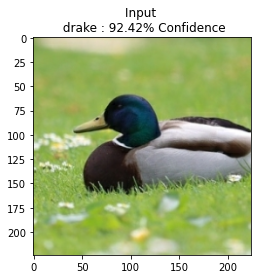

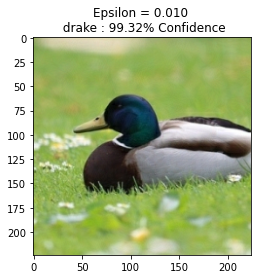

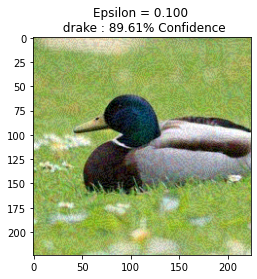

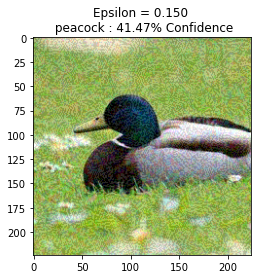

In [8]:
# image_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
image_path_test = image_path_base.format('256','duck')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

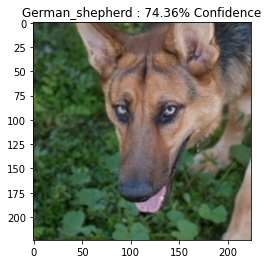

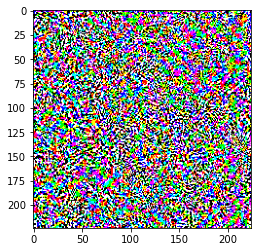

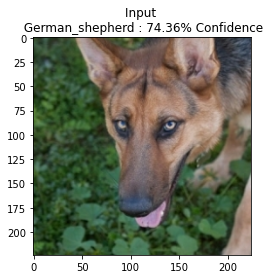

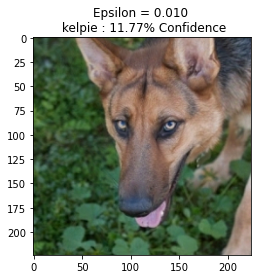

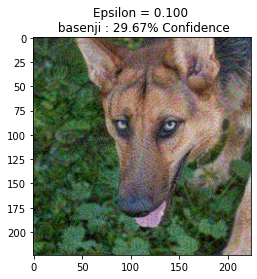

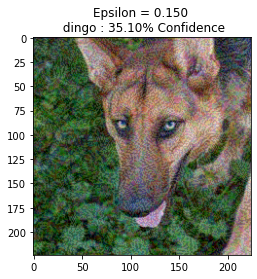

In [9]:
#### Different example
image_path_test = image_path_base.format('256','german_shepherd')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(235,image)

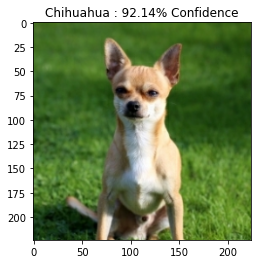

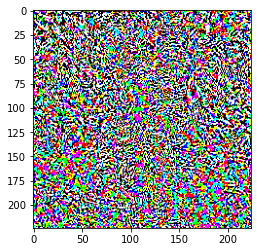

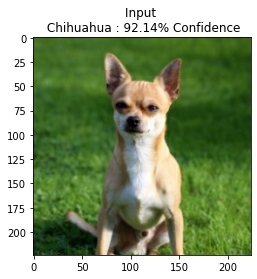

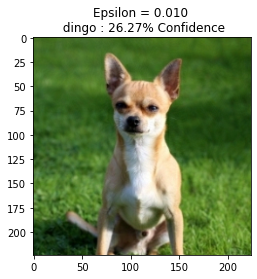

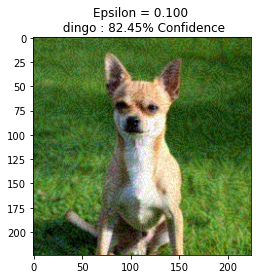

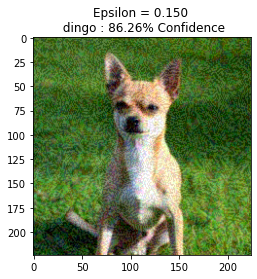

In [10]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','chihuahua')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(151,image)

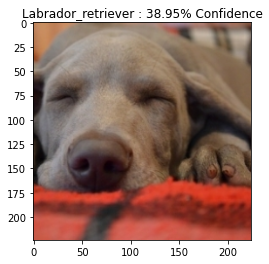

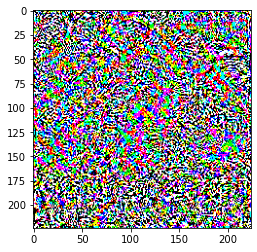

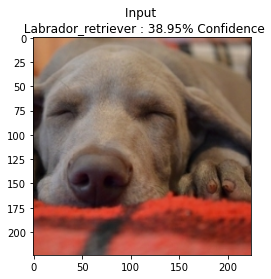

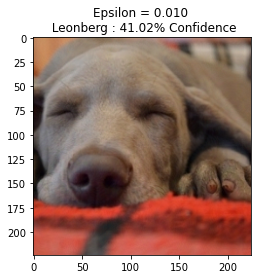

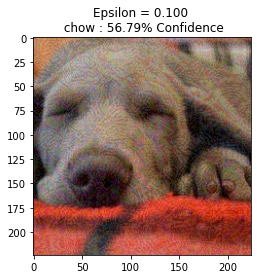

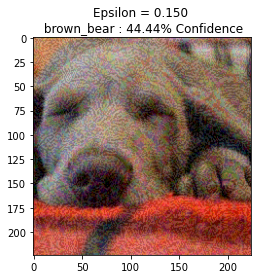

In [11]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','weimaraner')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(178,image)

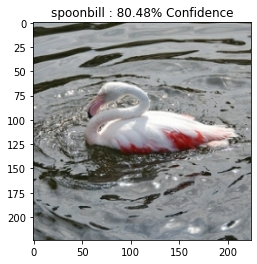

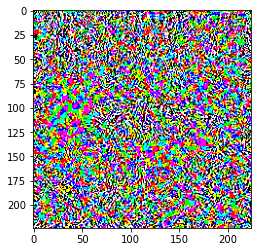

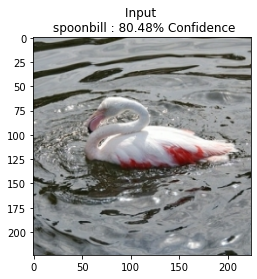

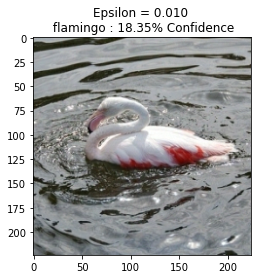

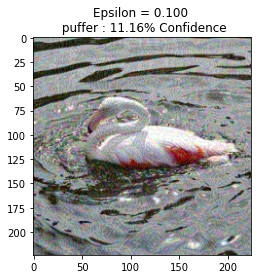

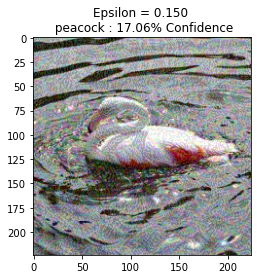

In [12]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)
show_images_perturbed(129,image) #spoonbill index

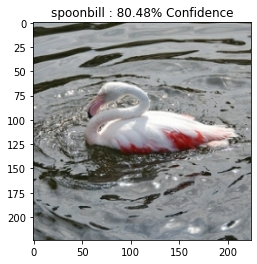

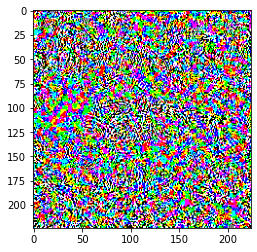

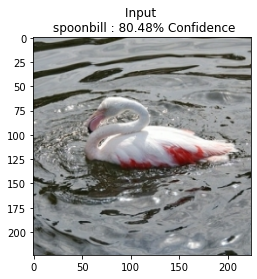

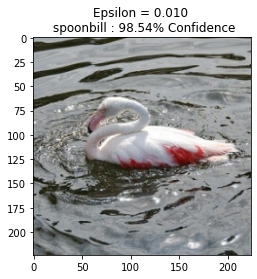

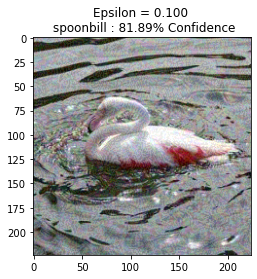

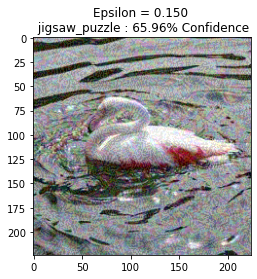

In [13]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

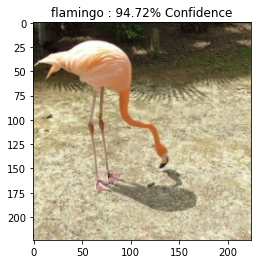

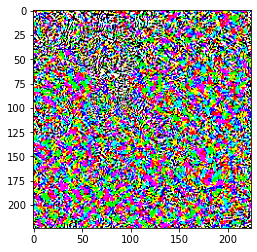

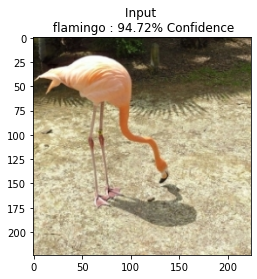

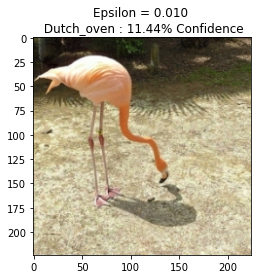

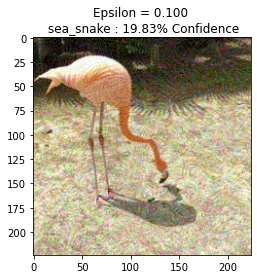

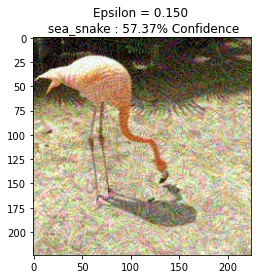

In [14]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','flamingo2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

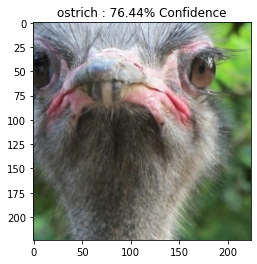

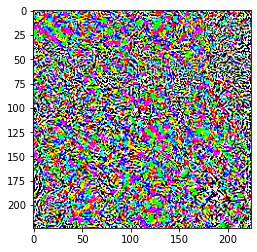

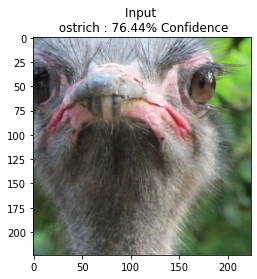

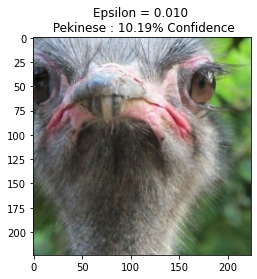

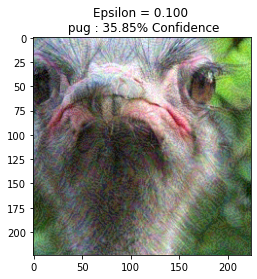

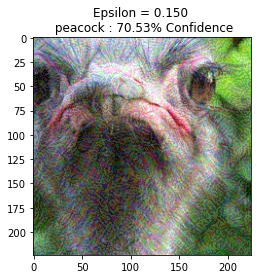

In [15]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','ostrich')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(9,image)

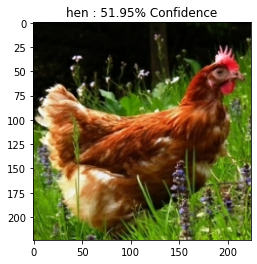

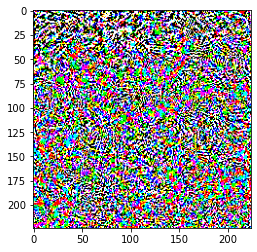

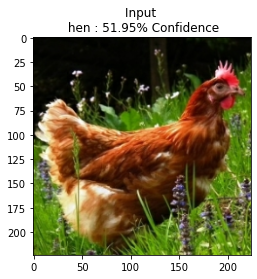

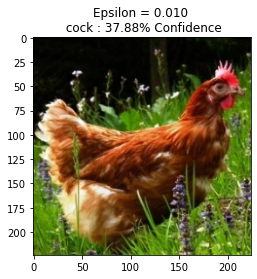

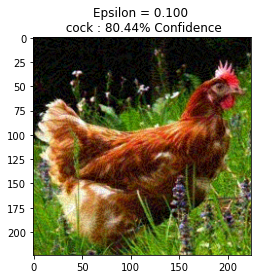

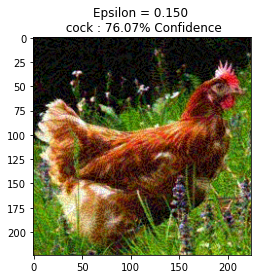

In [16]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','hen')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(8,image)

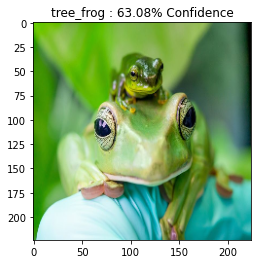

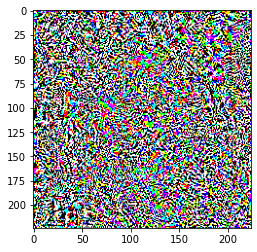

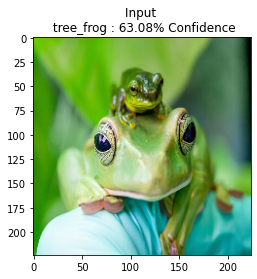

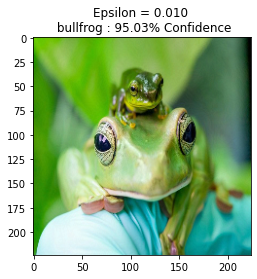

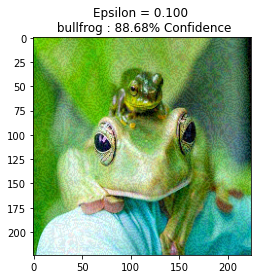

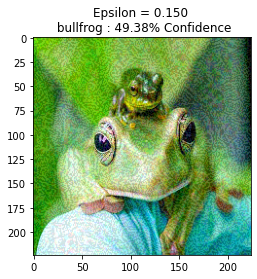

In [17]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','frogs')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(31,image)

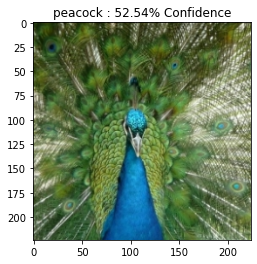

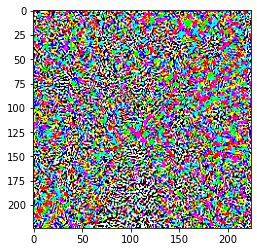

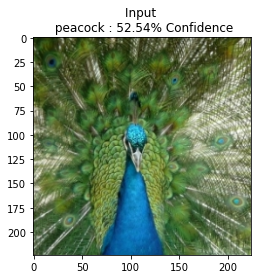

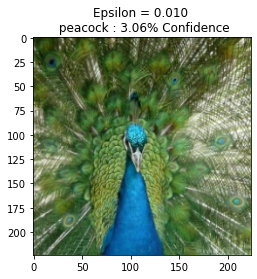

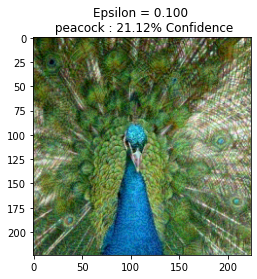

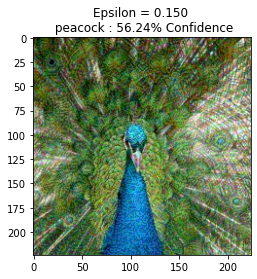

In [18]:
#### Different example peacock
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','peacock')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(84,image)

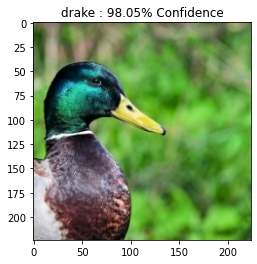

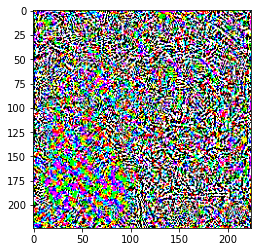

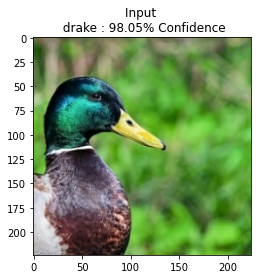

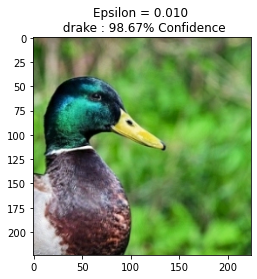

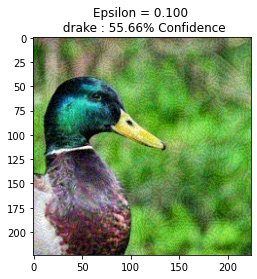

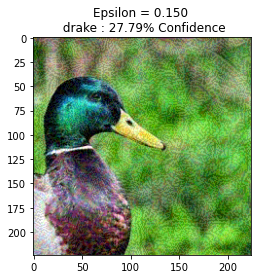

In [19]:
#### Different example
image_path_test = image_path_base.format('256','duck2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

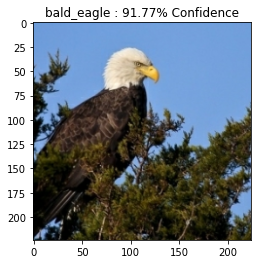

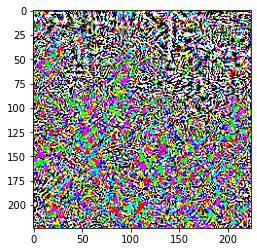

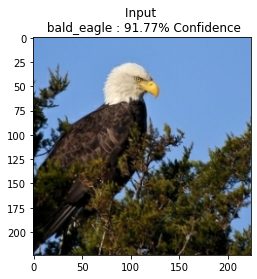

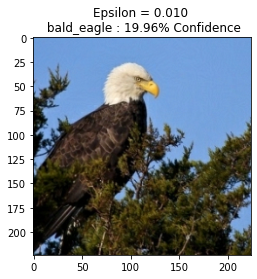

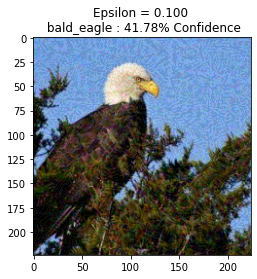

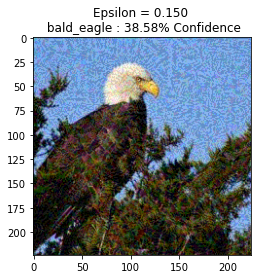

In [20]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','eagle')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(22,image)

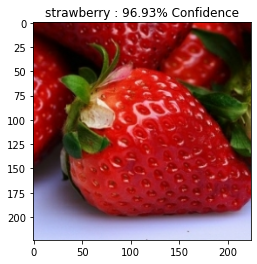

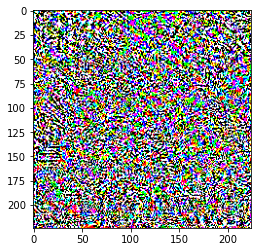

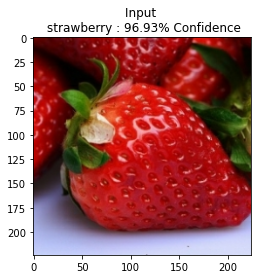

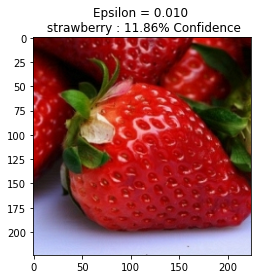

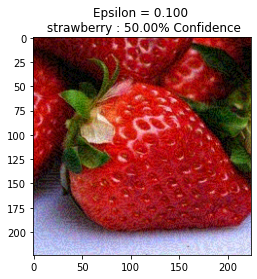

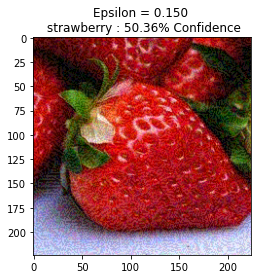

In [21]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format('256','strawberry')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(949,image)

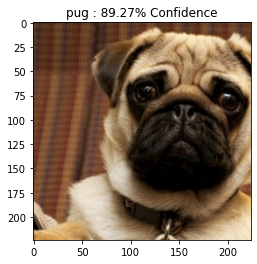

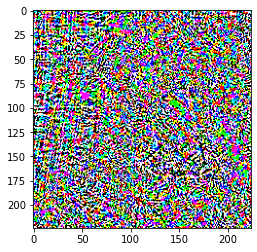

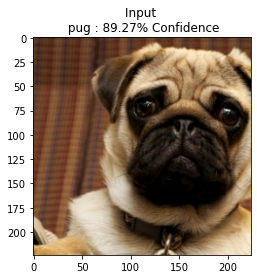

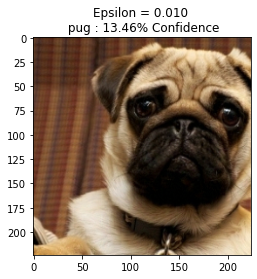

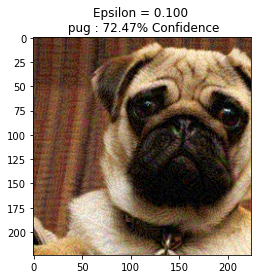

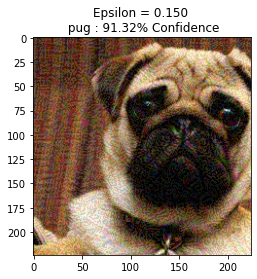

In [22]:
#### Different example
image_path_test = image_path_base.format('256','pug')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(254,image)

## Testing the MobileNetV2 with images that are 128x128

In [23]:
imsize_cur = 128

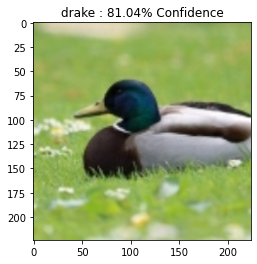

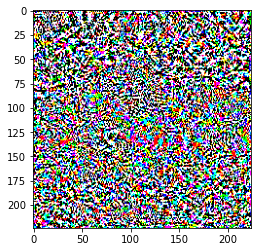

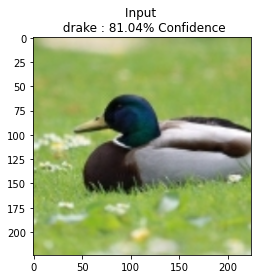

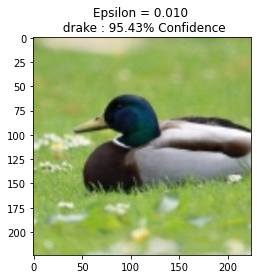

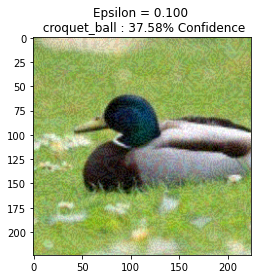

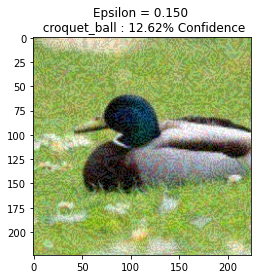

In [24]:
# image_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
image_path_test = image_path_base.format(imsize_cur,'duck')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

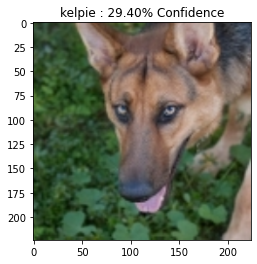

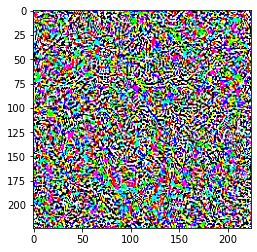

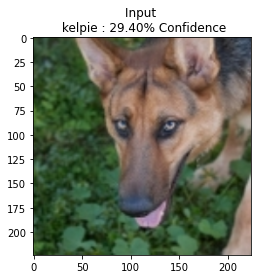

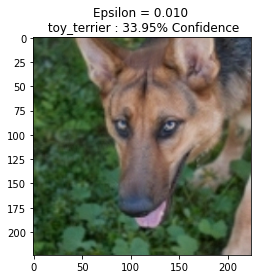

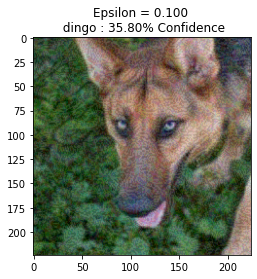

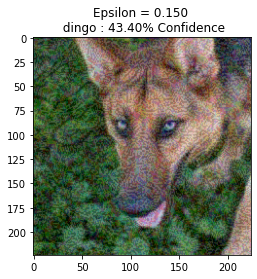

In [25]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'german_shepherd')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(235,image)

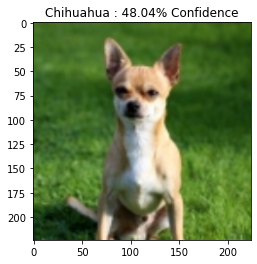

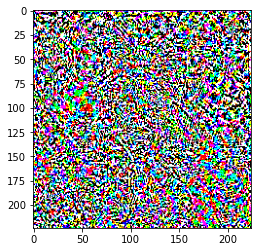

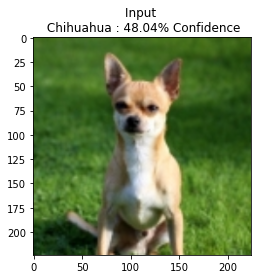

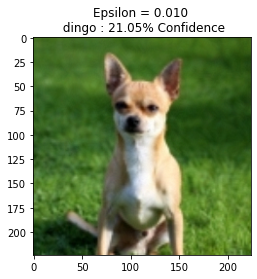

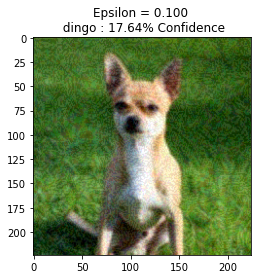

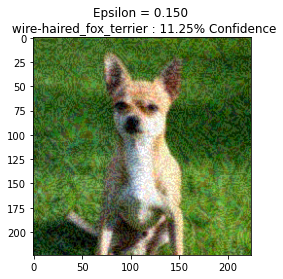

In [26]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'chihuahua')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(151,image)

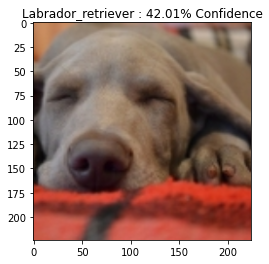

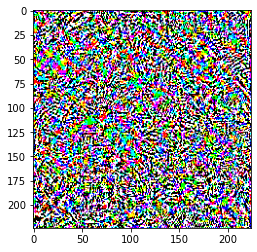

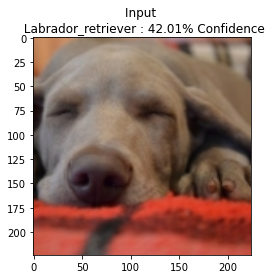

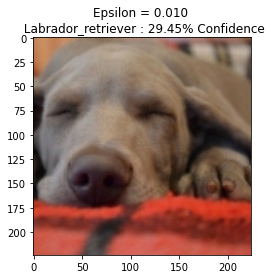

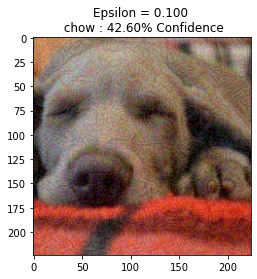

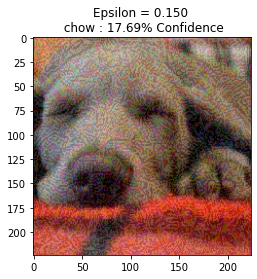

In [27]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'weimaraner')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(178,image)

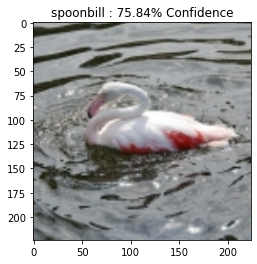

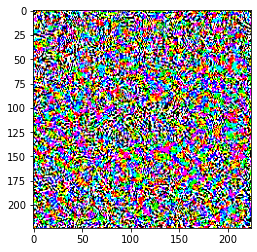

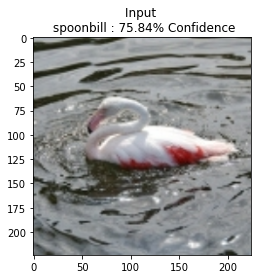

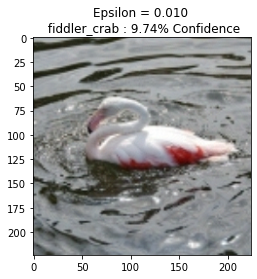

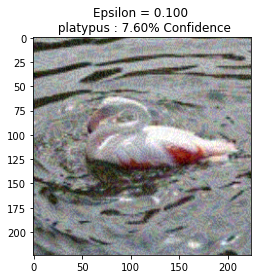

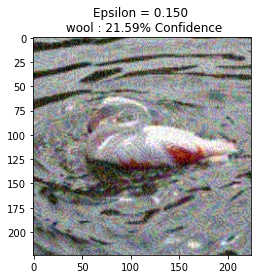

In [28]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)
show_images_perturbed(129,image) #spoonbill index

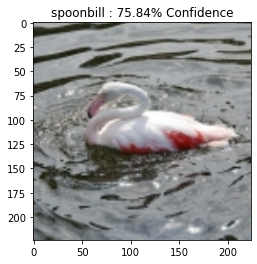

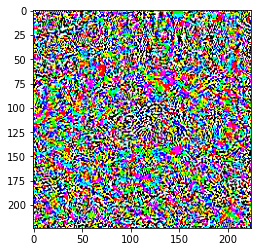

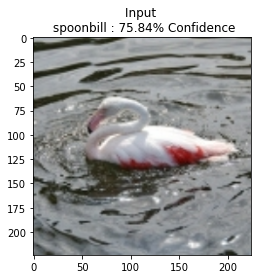

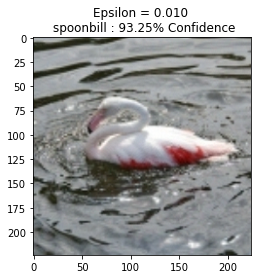

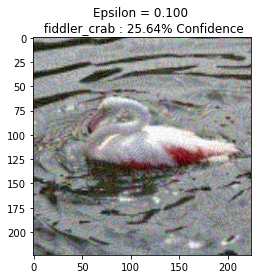

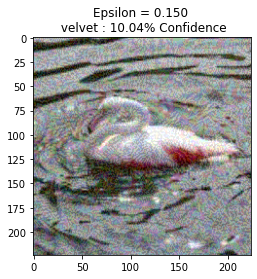

In [29]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

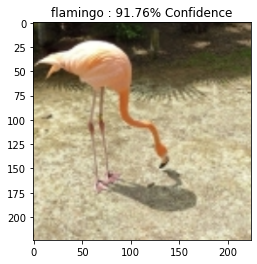

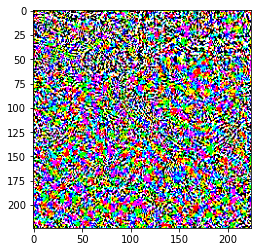

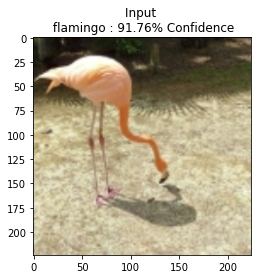

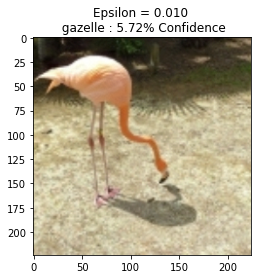

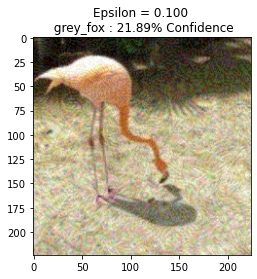

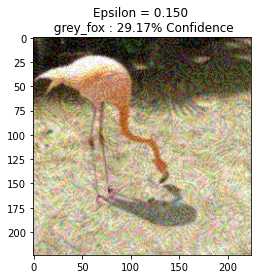

In [30]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

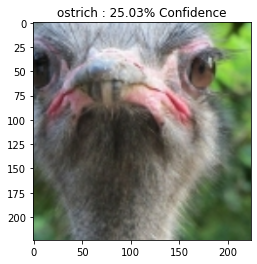

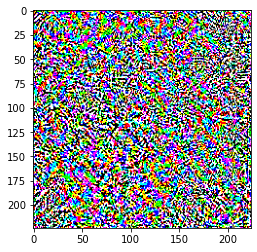

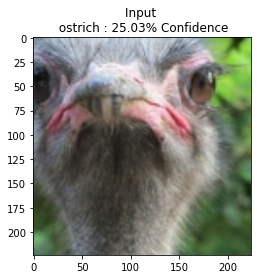

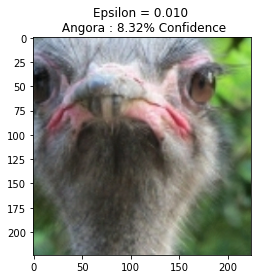

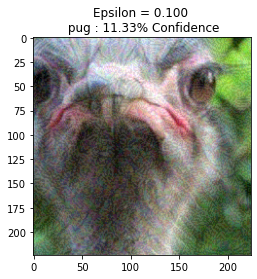

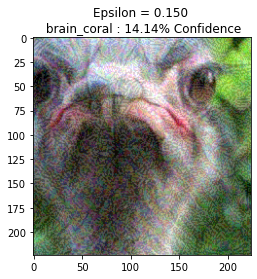

In [31]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'ostrich')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(9,image)

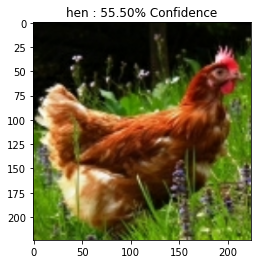

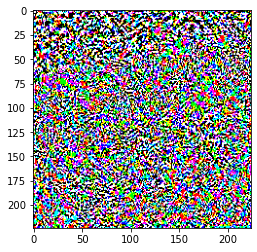

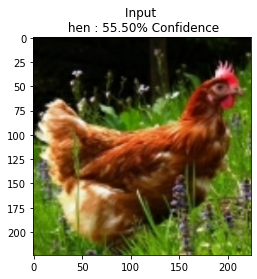

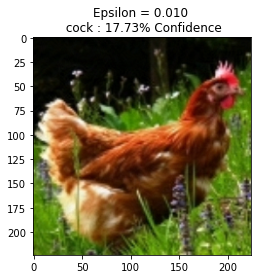

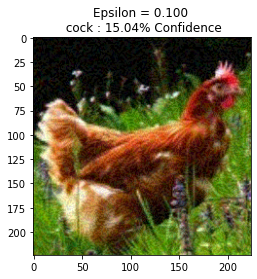

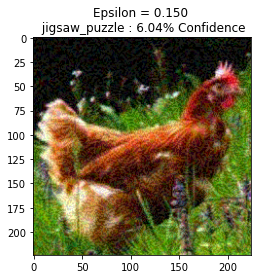

In [32]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'hen')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(8,image)

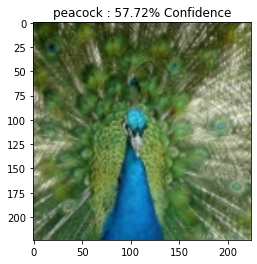

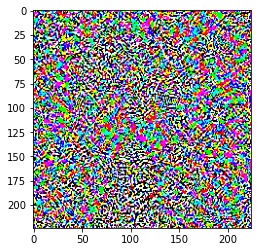

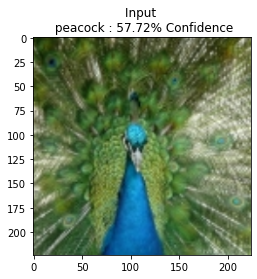

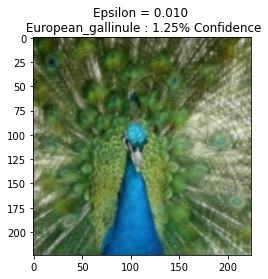

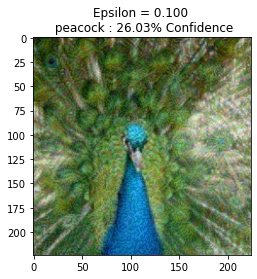

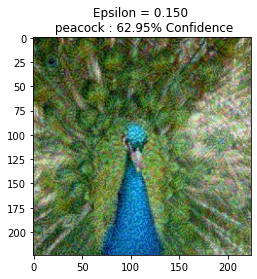

In [33]:
#### Different example peacock
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'peacock')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(84,image)

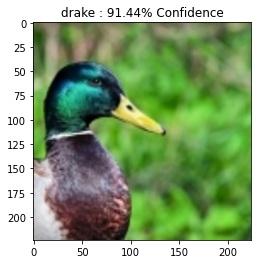

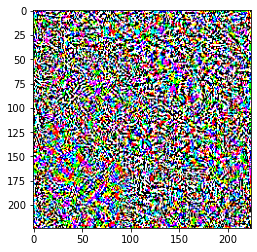

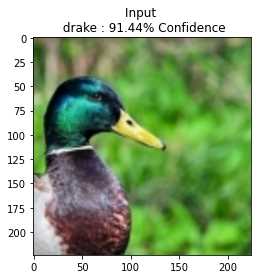

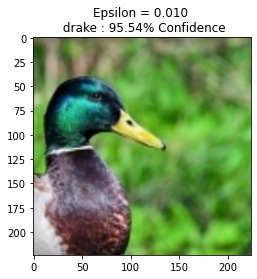

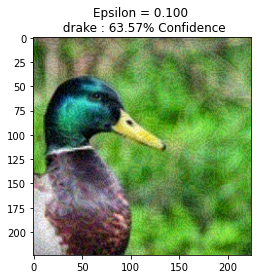

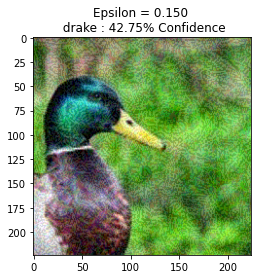

In [34]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'duck2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

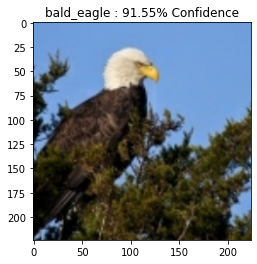

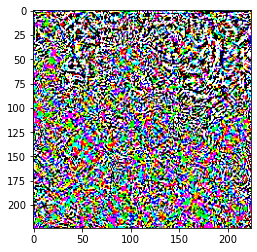

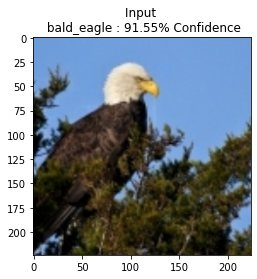

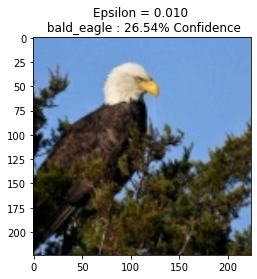

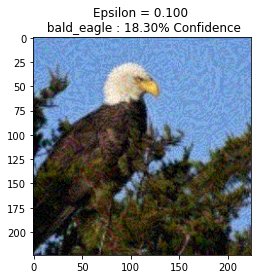

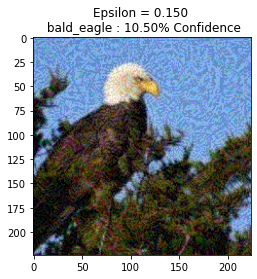

In [35]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'eagle')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(22,image)

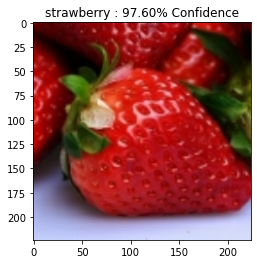

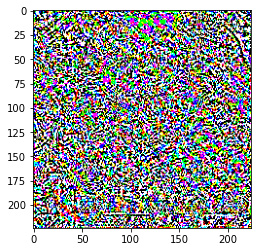

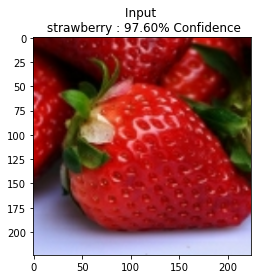

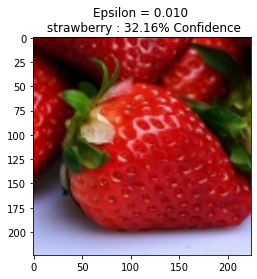

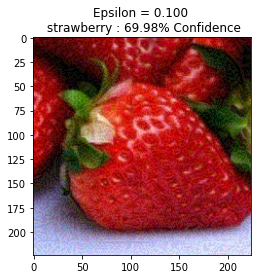

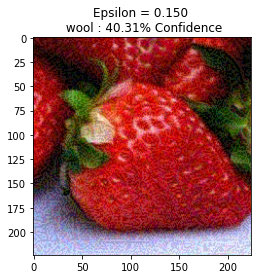

In [36]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'strawberry')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(949,image)

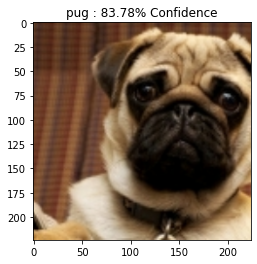

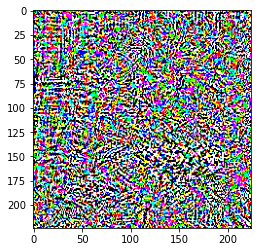

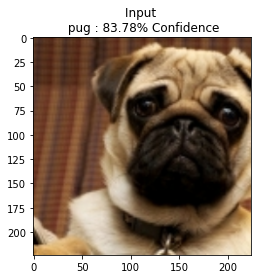

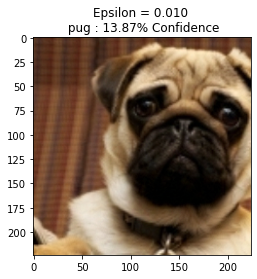

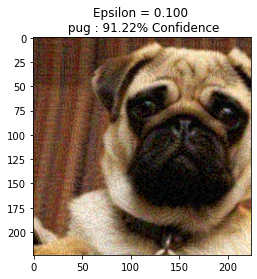

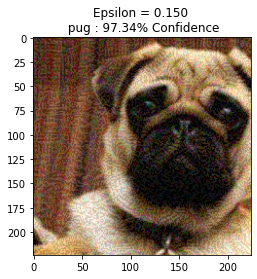

In [37]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'pug')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(254,image)

# Testing the MobileNetV2 with images that are 64x64

In [38]:
imsize_cur = 64

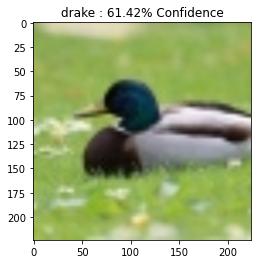

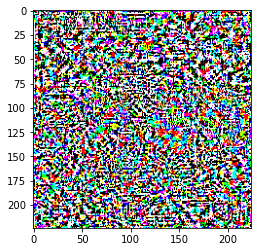

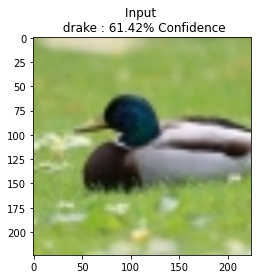

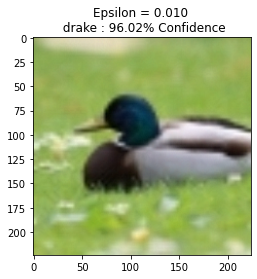

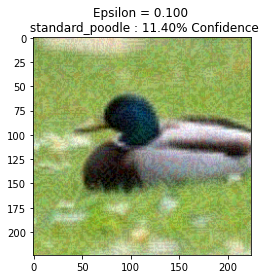

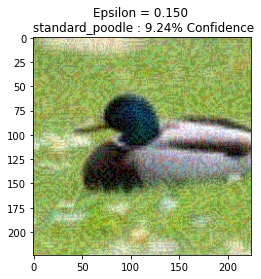

In [39]:
# image_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
image_path_test = image_path_base.format(imsize_cur,'duck')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

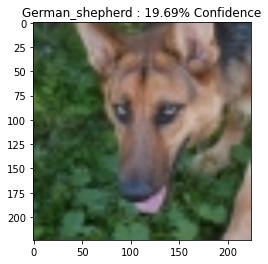

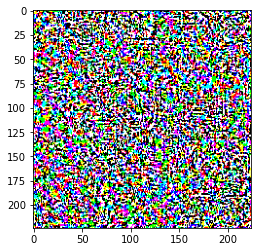

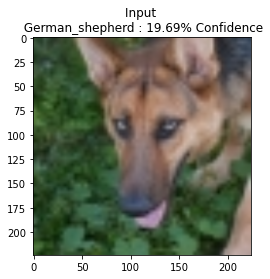

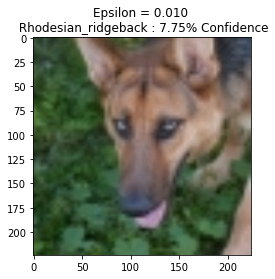

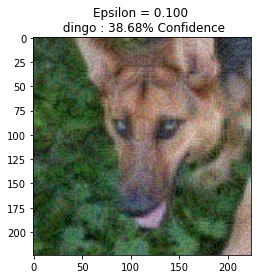

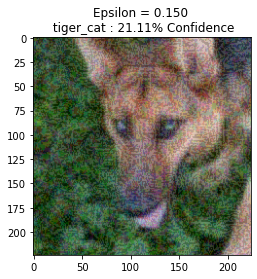

In [40]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'german_shepherd')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(235,image)

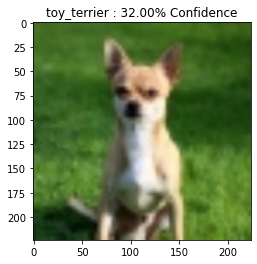

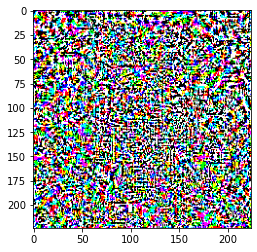

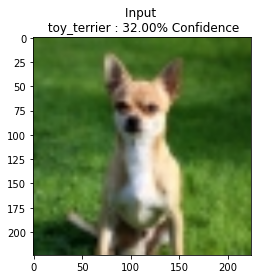

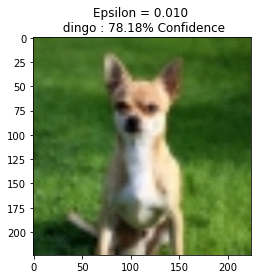

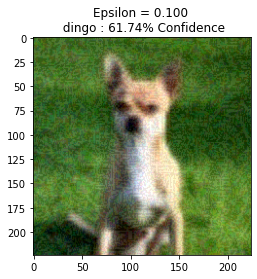

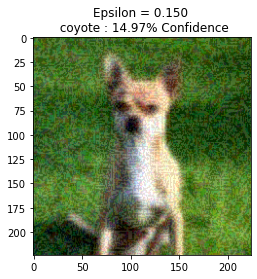

In [41]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'chihuahua')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(151,image)

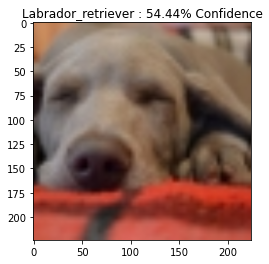

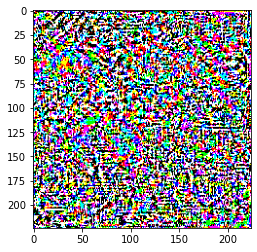

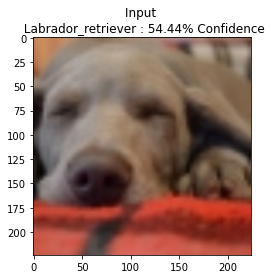

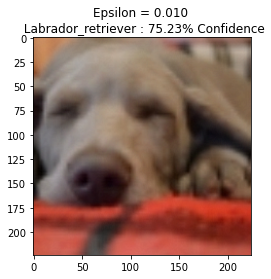

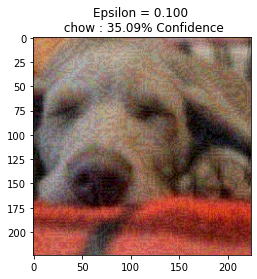

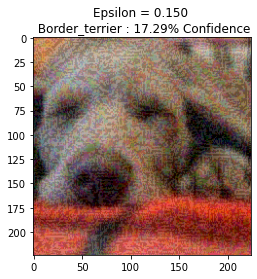

In [42]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'weimaraner')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(178,image)

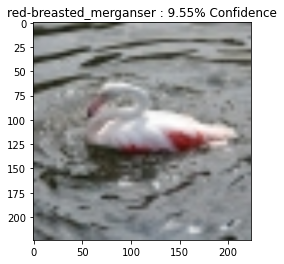

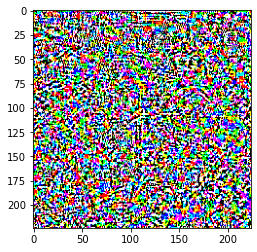

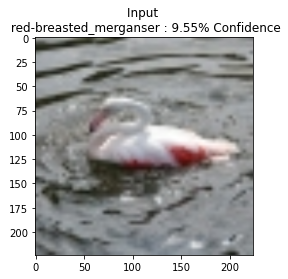

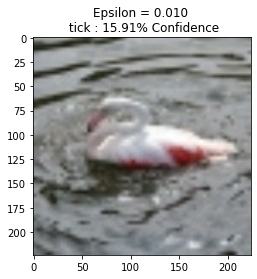

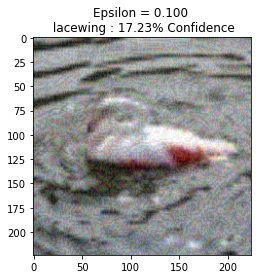

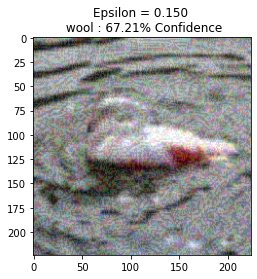

In [43]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)
show_images_perturbed(129,image) #spoonbill index

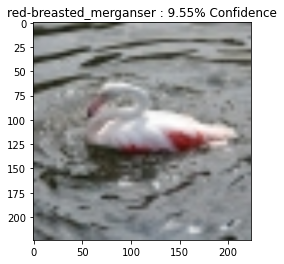

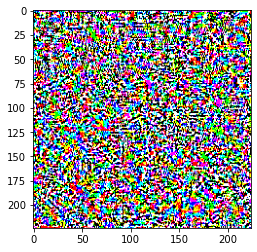

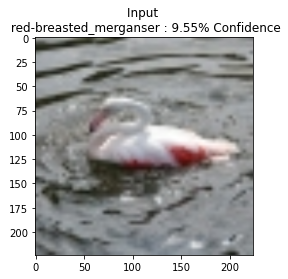

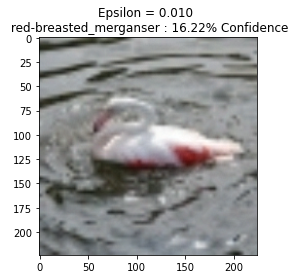

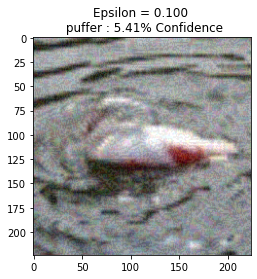

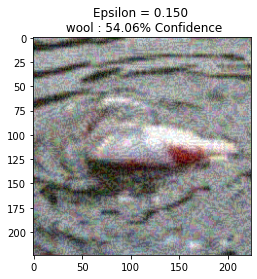

In [44]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

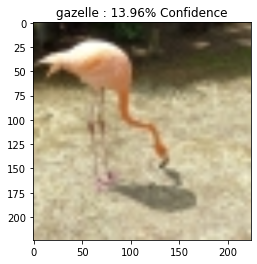

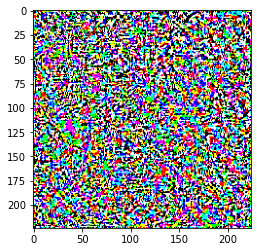

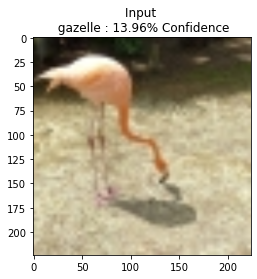

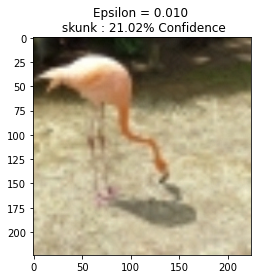

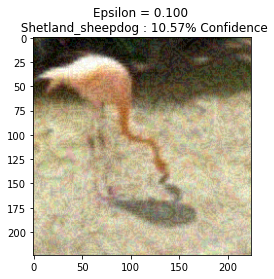

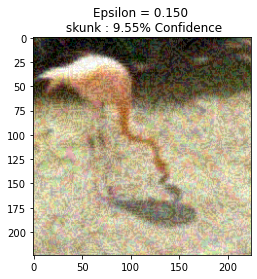

In [45]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

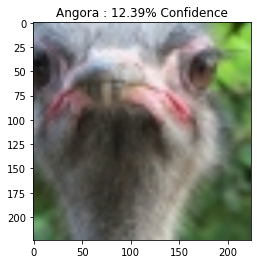

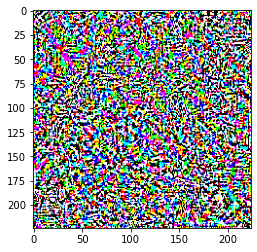

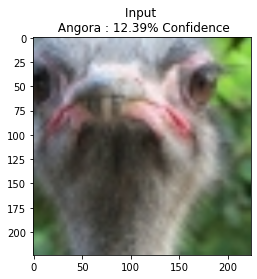

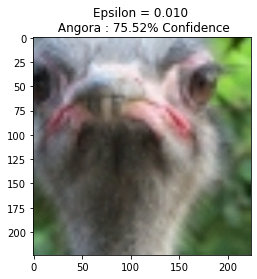

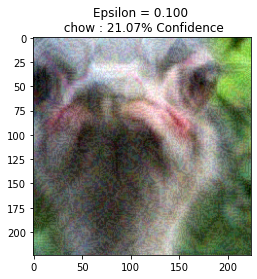

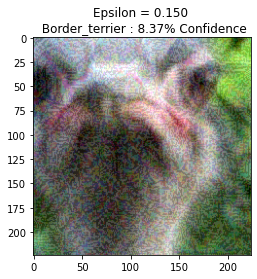

In [46]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'ostrich')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(9,image)

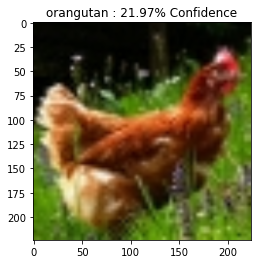

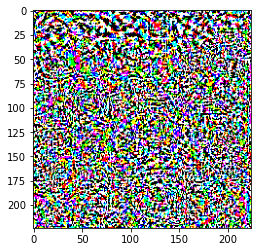

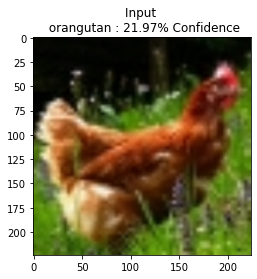

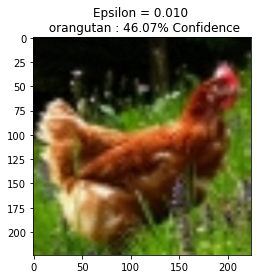

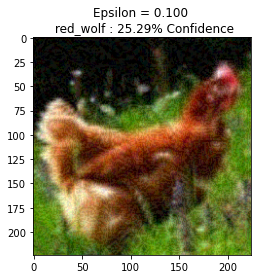

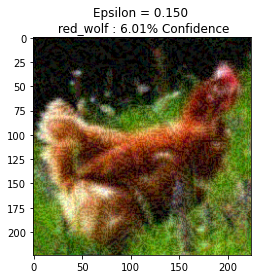

In [47]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'hen')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(8,image)

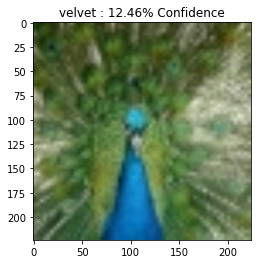

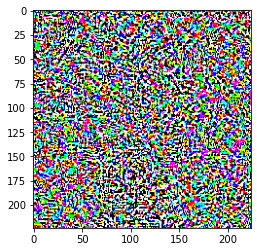

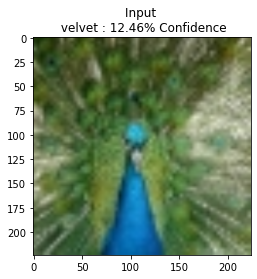

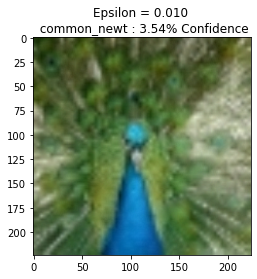

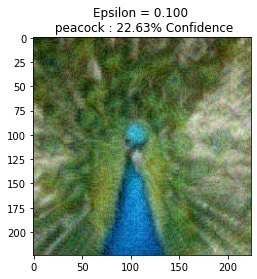

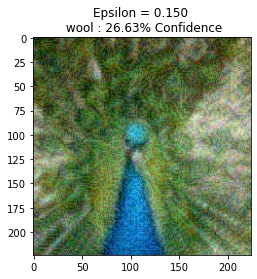

In [48]:
#### Different example peacock
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'peacock')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(84,image)

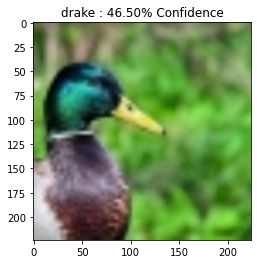

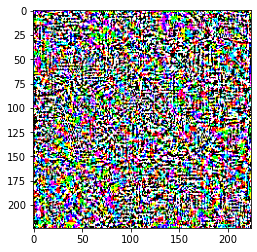

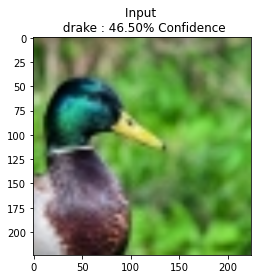

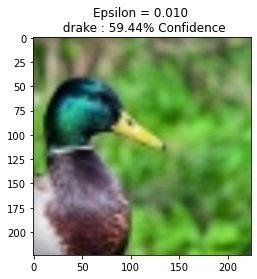

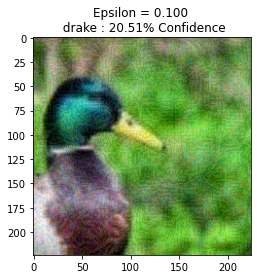

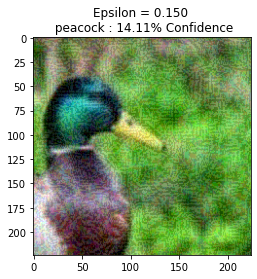

In [49]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'duck2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

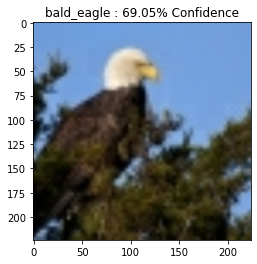

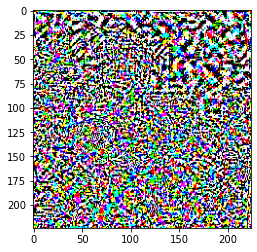

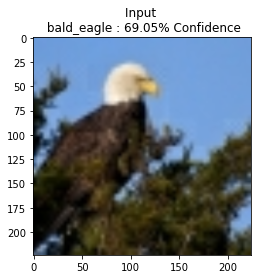

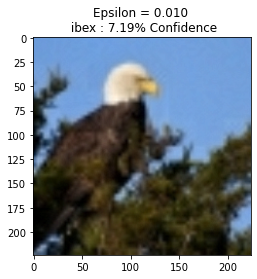

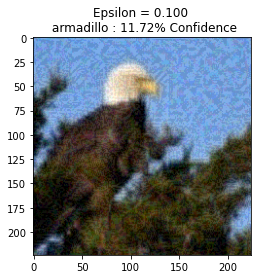

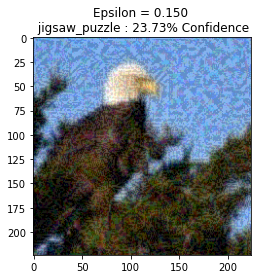

In [50]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'eagle')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(22,image)

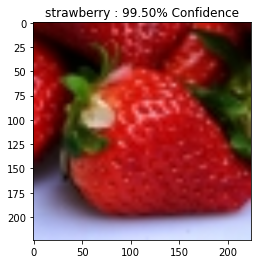

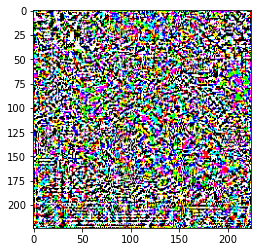

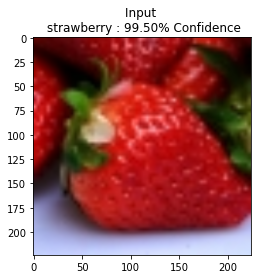

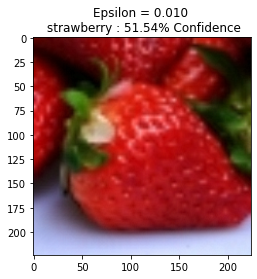

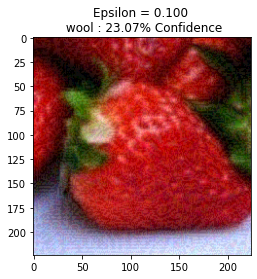

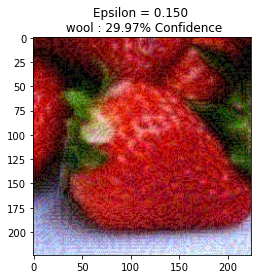

In [51]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'strawberry')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(949,image)

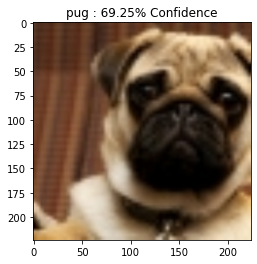

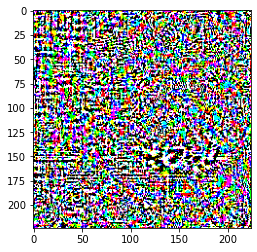

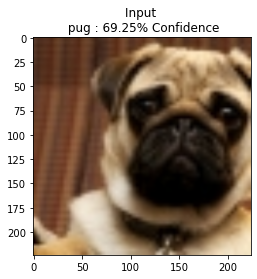

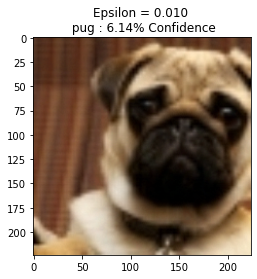

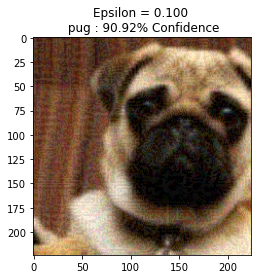

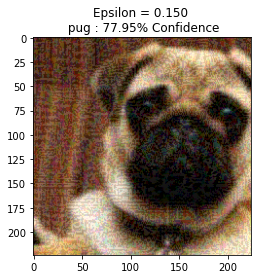

In [52]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'pug')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(254,image)

# Testing the MobileNetV2 with images that are 32x32

In [53]:
imsize_cur = 32

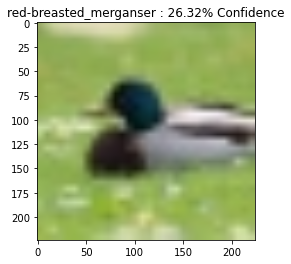

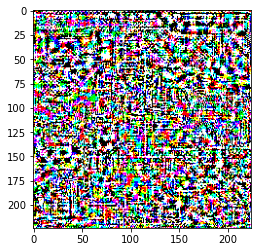

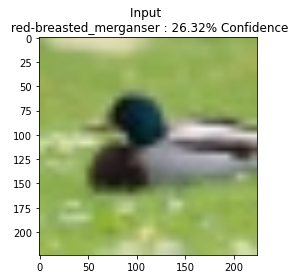

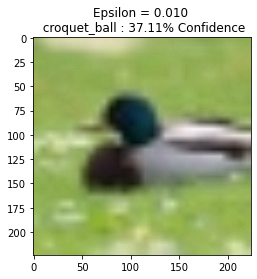

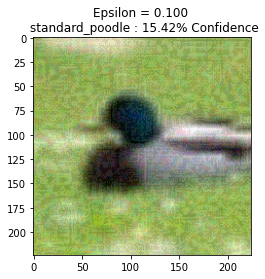

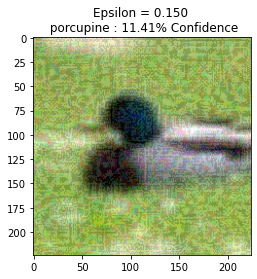

In [54]:
# image_path = tf.keras.utils.get_file('YellowLabradorLooking_new.jpg', 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg')
image_path_test = image_path_base.format(imsize_cur,'duck')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

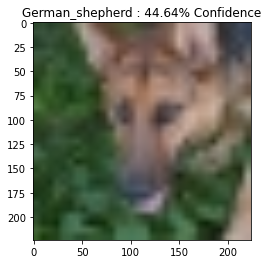

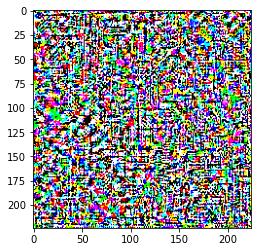

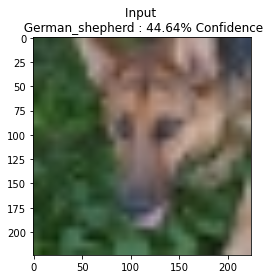

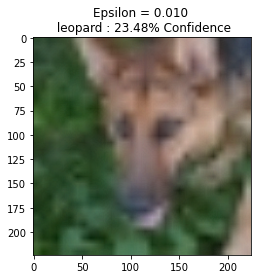

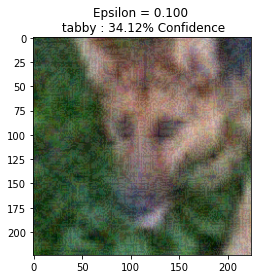

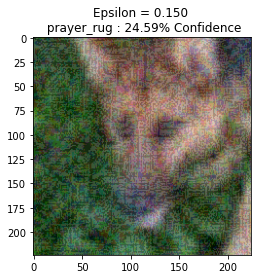

In [55]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'german_shepherd')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(235,image)

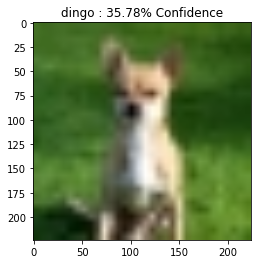

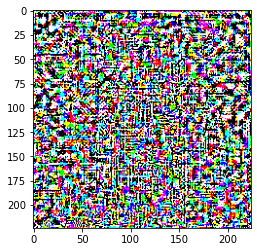

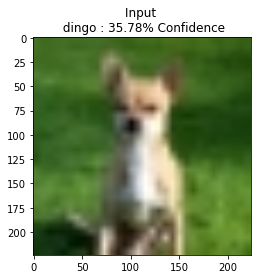

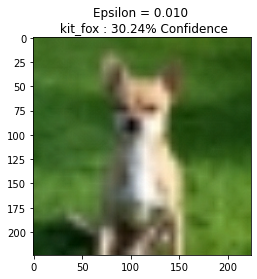

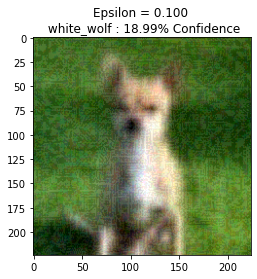

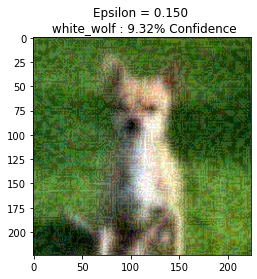

In [56]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'chihuahua')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(151,image)

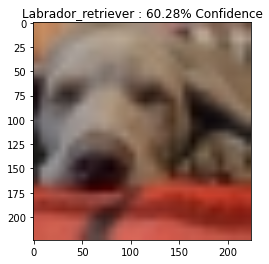

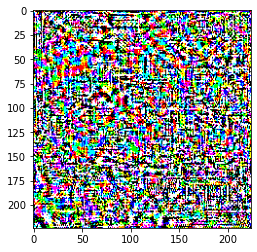

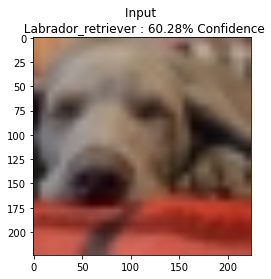

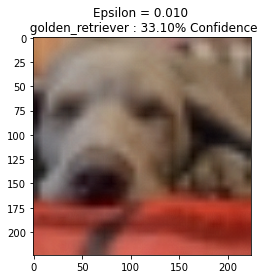

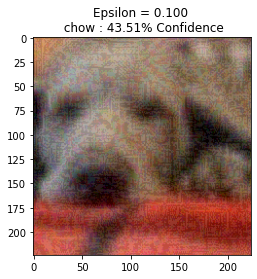

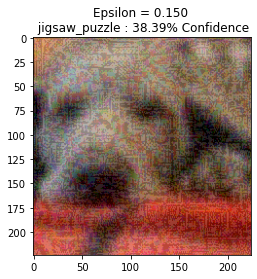

In [57]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'weimaraner')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(178,image)

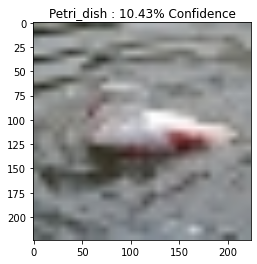

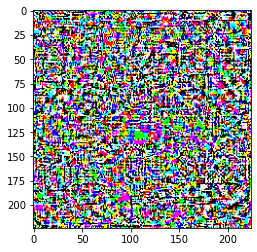

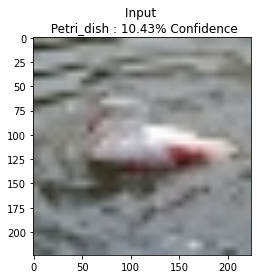

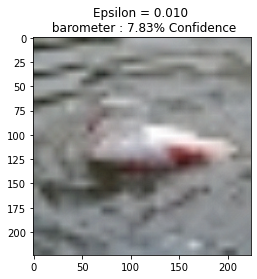

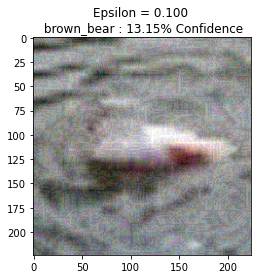

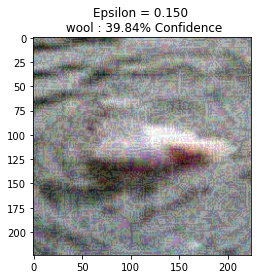

In [58]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)
show_images_perturbed(129,image) #spoonbill index

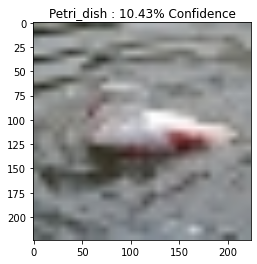

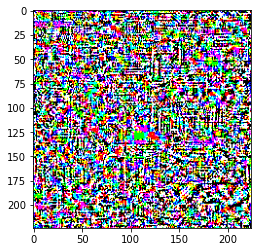

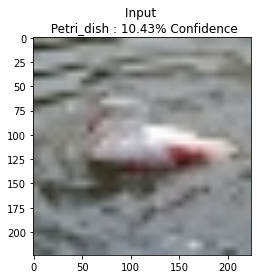

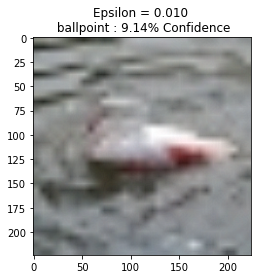

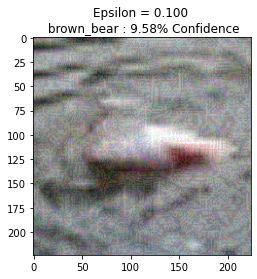

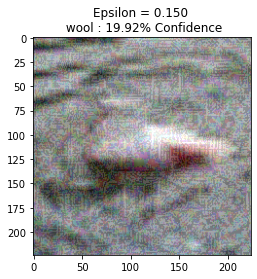

In [59]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

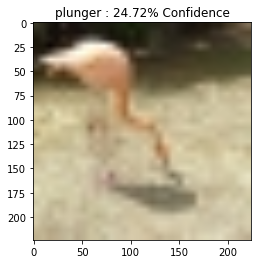

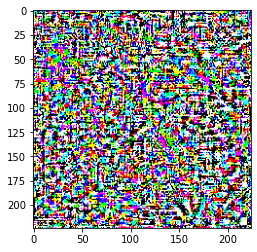

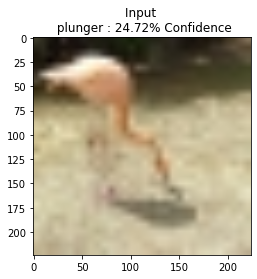

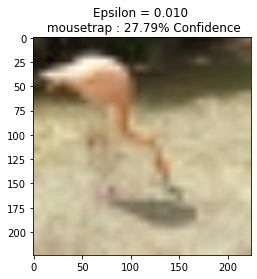

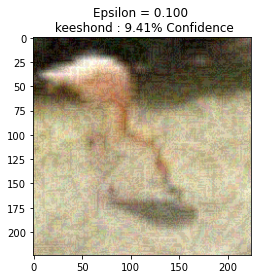

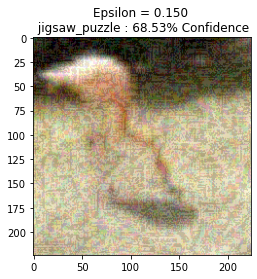

In [60]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'flamingo2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(130,image)

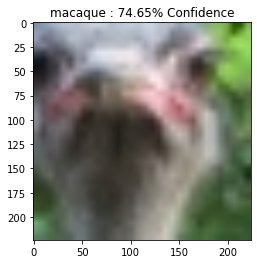

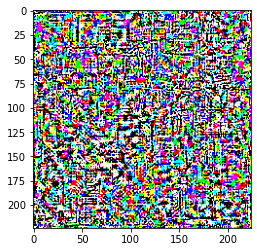

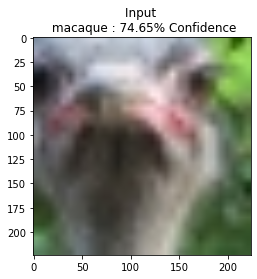

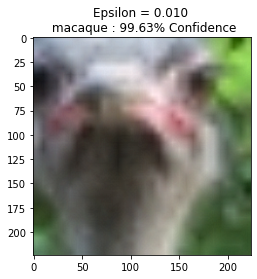

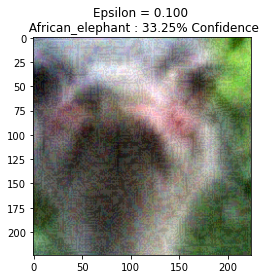

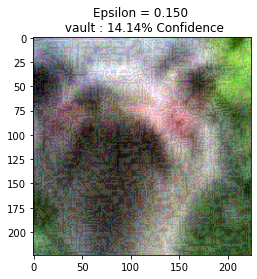

In [61]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'ostrich')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(9,image)

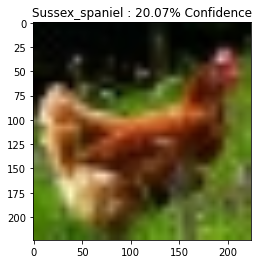

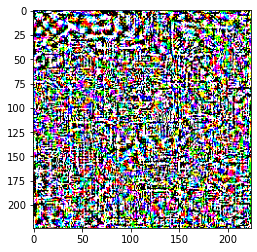

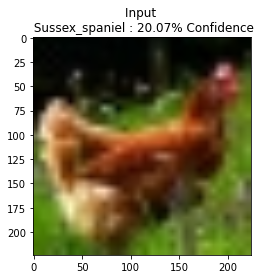

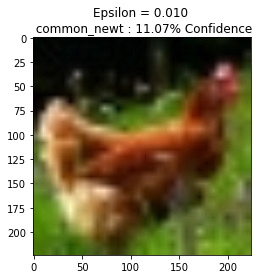

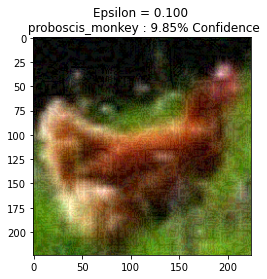

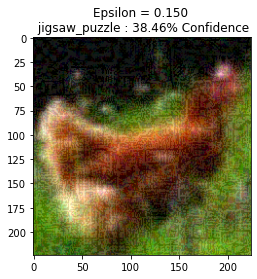

In [62]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'hen')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(8,image)

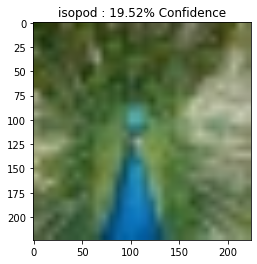

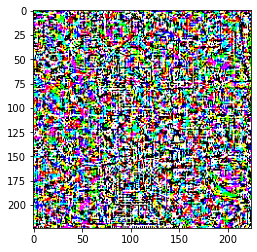

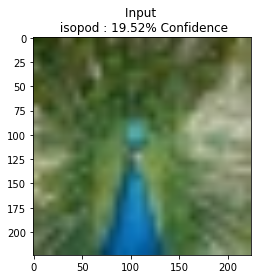

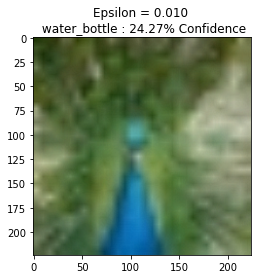

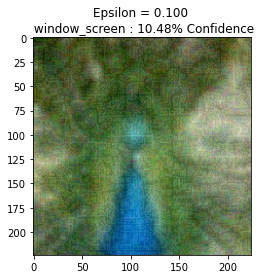

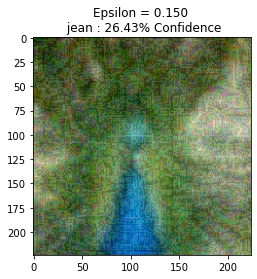

In [63]:
#### Different example peacock
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'peacock')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(84,image)

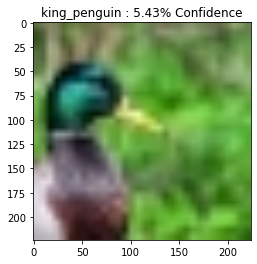

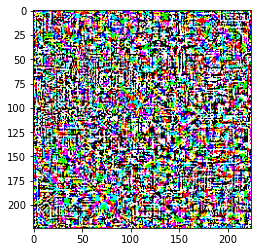

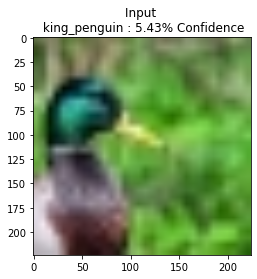

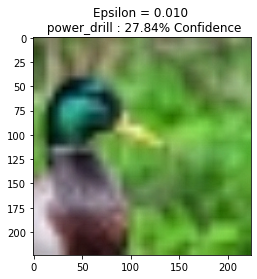

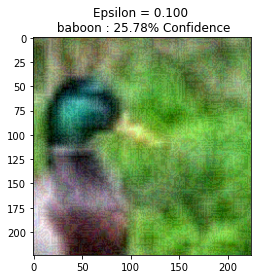

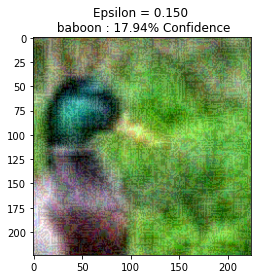

In [64]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'duck2')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(98,image)

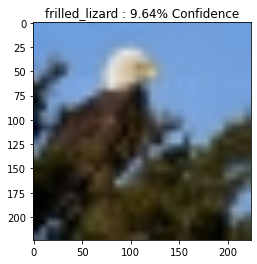

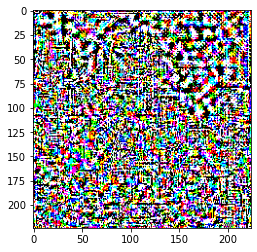

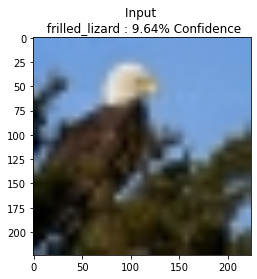

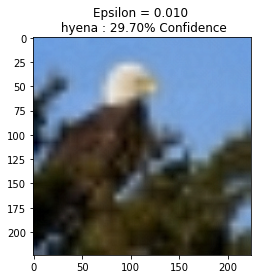

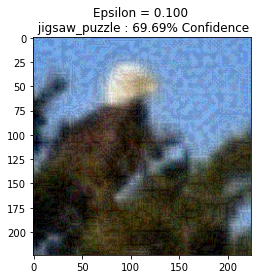

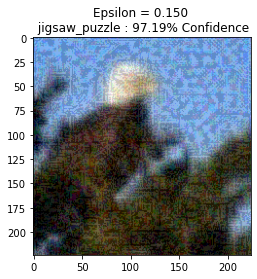

In [65]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'eagle')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(22,image)

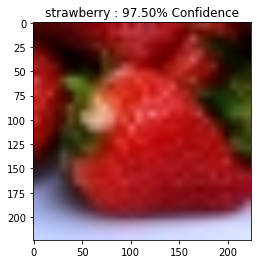

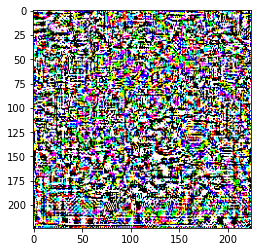

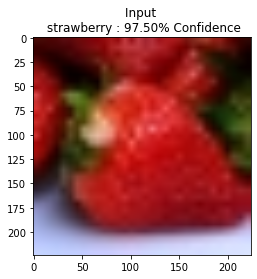

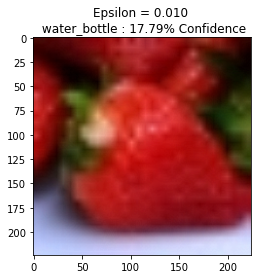

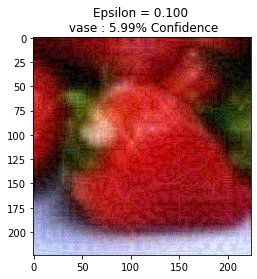

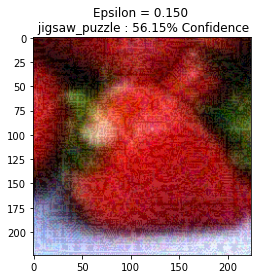

In [66]:
#### Different example chicekn
#labels https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a
image_path_test = image_path_base.format(imsize_cur,'strawberry')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(949,image)

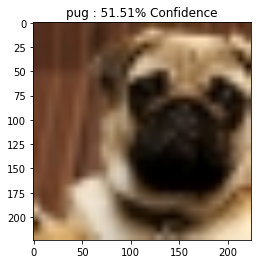

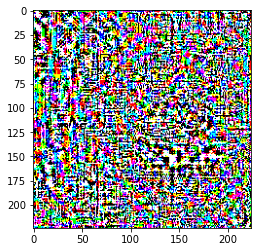

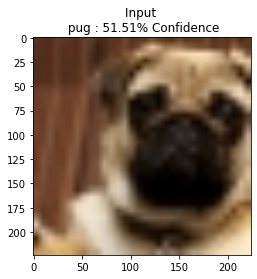

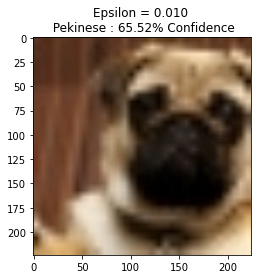

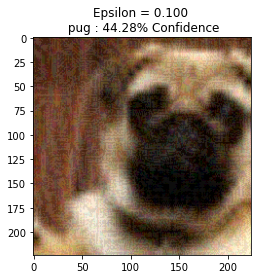

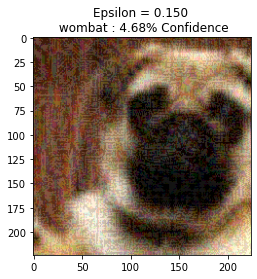

In [67]:
#### Different example
image_path_test = image_path_base.format(imsize_cur,'pug')
image_raw = tf.io.read_file(image_path_test)
image = tf.image.decode_image(image_raw)

show_images_perturbed(254,image)